In [ ]:
!pip install diffusers==0.11.1

# **Experiments on latent space exploration and influnce of $\sigma$**

#### Setup & Config

In [2]:
import tqdm
from diffusers import DDPMScheduler, DDIMScheduler
from diffusers import UNet2DModel
import torch
import PIL.Image
import numpy as np

In [3]:
def display_sample(sample, i):
    image_processed = sample.cpu().permute(0, 2, 3, 1)
    image_processed = (image_processed + 1.0) * 127.5
    image_processed = image_processed.numpy().astype(np.uint8)

    image_pil = PIL.Image.fromarray(image_processed[0])
    display(f"Image at step {i}")
    display(image_pil)

In [4]:
repo_id = "dvgodoy/ddpm-cifar10-32-mnist"
# repo_id = google/ddpm-bedroom-256"

In [ ]:
model = UNet2DModel.from_pretrained(repo_id)

In [20]:
model

UNet2DModel(
  (conv_in): Conv2d(3, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (time_proj): Timesteps()
  (time_embedding): TimestepEmbedding(
    (linear_1): Linear(in_features=128, out_features=512, bias=True)
    (act): SiLU()
    (linear_2): Linear(in_features=512, out_features=512, bias=True)
  )
  (down_blocks): ModuleList(
    (0): DownBlock2D(
      (resnets): ModuleList(
        (0-1): 2 x ResnetBlock2D(
          (norm1): GroupNorm(32, 128, eps=1e-06, affine=True)
          (conv1): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
          (time_emb_proj): Linear(in_features=512, out_features=128, bias=True)
          (norm2): GroupNorm(32, 128, eps=1e-06, affine=True)
          (dropout): Dropout(p=0.0, inplace=False)
          (conv2): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
          (nonlinearity): SiLU()
        )
      )
      (downsamplers): ModuleList(
        (0): Downsample2D(
          (conv): Conv2d(12

In [ ]:
scheduler = DDIMScheduler.from_config(repo_id)

In [21]:
scheduler

DDIMScheduler {
  "_class_name": "DDIMScheduler",
  "_diffusers_version": "0.11.1",
  "beta_end": 0.02,
  "beta_schedule": "linear",
  "beta_start": 0.0001,
  "clip_sample": true,
  "clip_sample_range": 1.0,
  "dynamic_thresholding_ratio": 0.995,
  "num_train_timesteps": 1000,
  "prediction_type": "epsilon",
  "sample_max_value": 1.0,
  "set_alpha_to_one": true,
  "steps_offset": 0,
  "thresholding": false,
  "trained_betas": null,
  "variance_type": "fixed_large"
}

In [7]:
schedulerDDPM = DDPMScheduler.from_config(repo_id)

The config attributes {'clip_sample_range': 1.0} were passed to DDPMScheduler, but are not expected and will be ignored. Please verify your scheduler_config.json configuration file.


In [8]:
scheduler.set_timesteps(num_inference_steps = 10)
schedulerDDPM.set_timesteps(num_inference_steps = 1000)

## **Latent Space Exploration**

In [ ]:
sigma = 0
model.to("cuda")
img_sigma_samples_DDPM = {}
for n in range(10):

  torch.manual_seed(n)
  noisy_sample = torch.randn(
    1, model.config.in_channels, model.config.sample_size, model.config.sample_size
)

  noisy_sample = noisy_sample.to("cuda")
  
  sample = noisy_sample
  print(sample.shape)
  for i, t in enumerate(tqdm.tqdm(schedulerDDPM.timesteps)):
    # 1. predict noise residual
    with torch.no_grad():
        residual = model(sample, t).sample

    # 2. compute previous image and set x_t -> x_t-1
    sample = schedulerDDPM.step(residual, t, sample).prev_sample

  # 3. optionally look at image
    if (i + 1) % 200 == 0:
      print(i)
      if n == 0 : 
        img_sigma_samples_DDPM[i] = [sample]
      else : 
        img_sigma_samples_DDPM[i].append(sample)


In [ ]:
img_sigma_samples = {}

model.to("cuda")


for sigma in [0.0]:
  images_samples = []
  for n in range(10):
    torch.manual_seed(n)
    noisy_sample = torch.randn(
      1, model.config.in_channels, model.config.sample_size, model.config.sample_size
  )

    noisy_sample = noisy_sample.to("cuda")
    
    sample = noisy_sample
    print(sample.shape)
    for i, t in enumerate(tqdm.tqdm(scheduler.timesteps)):
      # 1. predict noise residual
      with torch.no_grad():
          residual = model(sample, t).sample

      # 2. compute previous image and set x_t -> x_t-1
      sample = scheduler.step(residual, t, sample, eta = sigma).prev_sample
    images_samples.append(sample)
  img_sigma_samples[sigma] = images_samples


In [ ]:


model.to("cuda")

images_samples = []
for n in range(5):
  torch.manual_seed(n)
  noisy_sample = torch.randn(
    1, model.config.in_channels, model.config.sample_size, model.config.sample_size
)

  noisy_sample = noisy_sample.to("cuda")
  
  sample = noisy_sample
  print(sample.shape)
  for i, t in enumerate(tqdm.tqdm(schedulerDDPM.timesteps)):
    # 1. predict noise residual
    with torch.no_grad():
        residual = model(sample, t).sample

    # 2. compute previous image and set x_t -> x_t-1
    sample = schedulerDDPM.step(residual, t, sample).prev_sample
  images_samples.append(sample)
img_sigma_samples_DDPM = images_samples

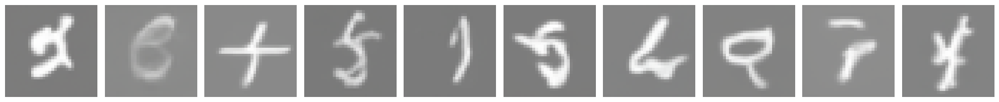

In [11]:
import matplotlib.pyplot as plt
n_samples = 10
sample_idcs = range(10)
fig, axs = plt.subplots(len(img_sigma_samples), n_samples, figsize=(20,10))
for i, (sigma, imgs) in enumerate(img_sigma_samples.items()):
    for j, idx in enumerate(sample_idcs):
        image_processed = imgs[idx].cpu().permute(0, 2, 3, 1)
        image_processed = (image_processed + 1.0) * 127.5
        image_processed = image_processed.numpy().astype(np.uint8)
        axs[j].imshow(image_processed[0,:,:,:])
        axs[j].axis('off')
plt.tight_layout()
plt.savefig('mnist_10ts.png', bbox_inches='tight')
plt.show()

100%|██████████| 100/100 [00:01<00:00, 55.14it/s]


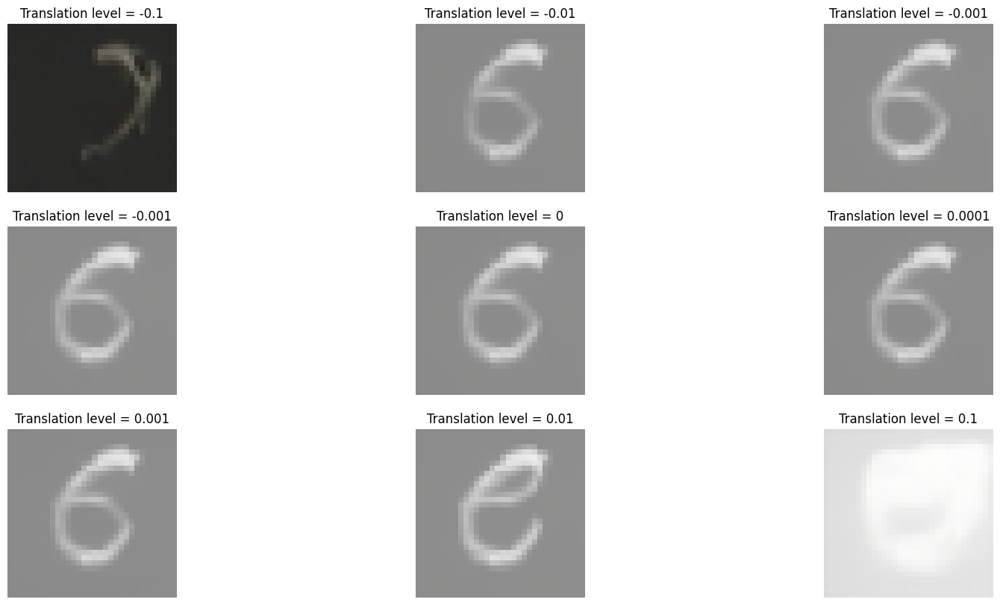

In [15]:
### more 6 
torch.manual_seed(1)
noisy_sample = torch.randn(
      1, model.config.in_channels, model.config.sample_size, model.config.sample_size
  )
fig, axs = plt.subplots(3, 3, figsize=(20,10))
for k,translation in enumerate([-1e-1,-1e-2,-1e-3,-1e-3,0,1e-4,1e-3,1e-2,1e-1]):
  noisy_sample_t = noisy_sample + translation
  noisy_sample_t = noisy_sample_t.to("cuda")
  sample = noisy_sample_t
  scheduler.set_timesteps(num_inference_steps = 100)
  for i, t in enumerate(tqdm.tqdm(scheduler.timesteps)):
        # 1. predict noise residual
      with torch.no_grad():
            residual = model(sample, t).sample
      sample = scheduler.step(residual, t, sample, eta = 0).prev_sample
  image_processed = sample.cpu().permute(0, 2, 3, 1)
  image_processed = (image_processed + 1.0) * 127.5
  axs[k//3,k%3].set_title("Translation level = {}".format(translation))
  image_processed = image_processed.numpy().astype(np.uint8)
  axs[k//3,k%3].imshow(image_processed[0,:,:,:])
  axs[k//3,k%3].axis('off')

100%|██████████| 100/100 [00:02<00:00, 40.71it/s]


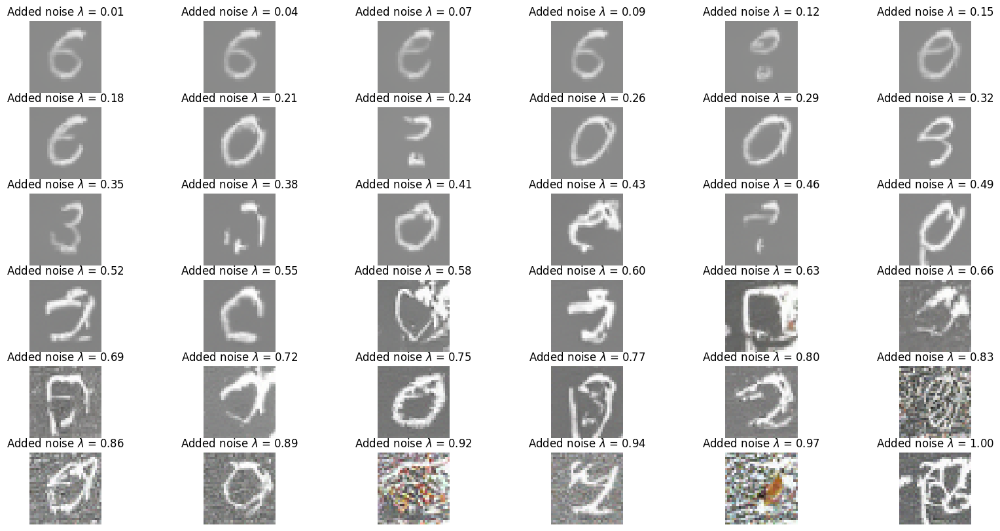

In [34]:
### more 6 
torch.manual_seed(1)
noisy_sample = torch.randn(
      1, model.config.in_channels, model.config.sample_size, model.config.sample_size
  )
scheduler.set_timesteps(num_inference_steps = 100)
fig, axs = plt.subplots(6, 6, figsize=(20,10))
for k,translation in enumerate(np.linspace(0.01,1,36)):
  noisy_sample_t = noisy_sample + translation * torch.randn(*noisy_sample.shape)
  noisy_sample_t = noisy_sample_t.to("cuda")
  sample = noisy_sample_t
  
  for i, t in enumerate(tqdm.tqdm(scheduler.timesteps)):
        # 1. predict noise residual
      with torch.no_grad():
            residual = model(sample, t).sample
      sample = scheduler.step(residual, t, sample, eta = 0).prev_sample
  image_processed = sample.cpu().permute(0, 2, 3, 1)
  image_processed = (image_processed + 1.0) * 127.5
  axs[k//6,k%6].set_title(r"Added noise $\lambda$ = {0:.2f}".format(translation))
  image_processed = image_processed.numpy().astype(np.uint8)
  axs[k//6,k%6].imshow(image_processed[0,:,:,:])
  axs[k//6,k%6].axis('off')

## **Influence of $\sigma$ on image quality for different timesteps**

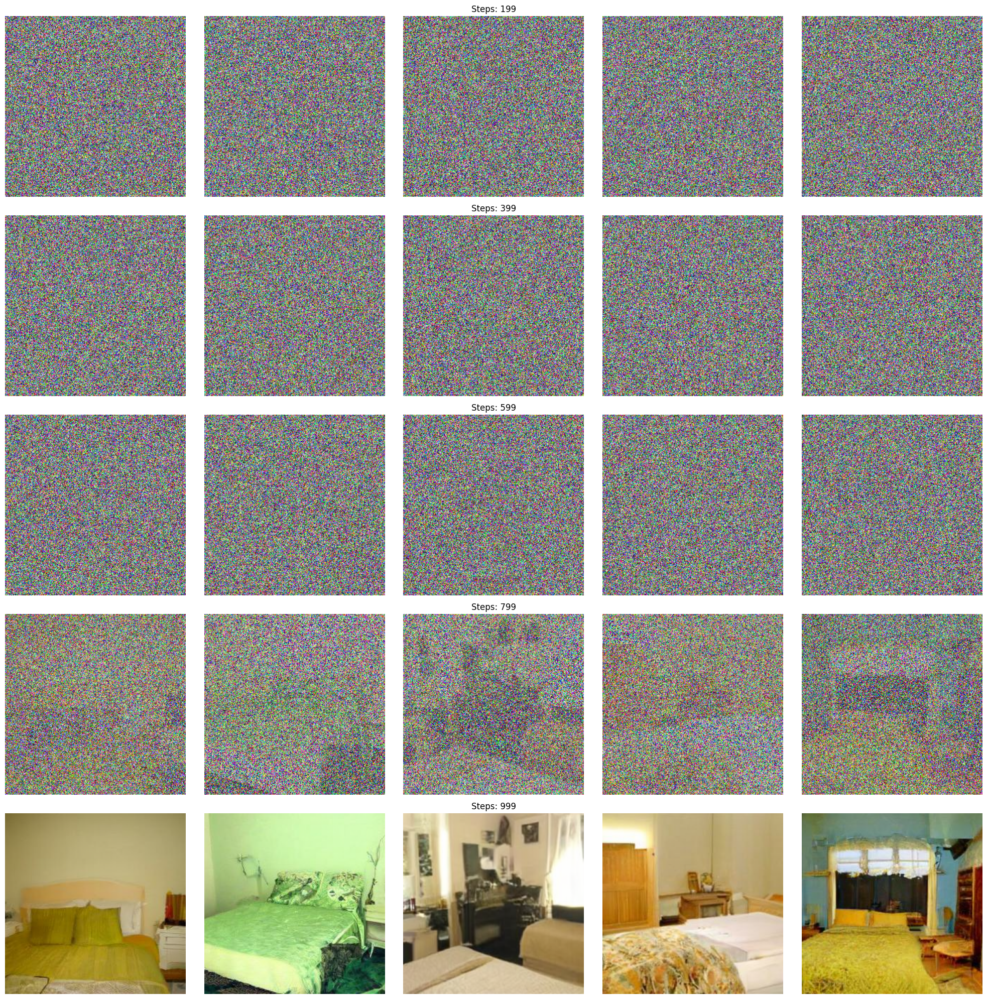

In [ ]:
import matplotlib.pyplot as plt
n_samples = 5
sample_idcs = range(5)

fig, axs = plt.subplots(len(img_sigma_samples_DDPM), n_samples, figsize=(4 * len(img_sigma_samples_DDPM), 4 * n_samples))
for i, (sigma, imgs) in enumerate(img_sigma_samples_DDPM.items()):
    axs[i, 2].set_title(f"Steps: {sigma}")
    for j, idx in enumerate(sample_idcs):
        image_processed = imgs[idx].cpu().permute(0, 2, 3, 1)
        image_processed = (image_processed + 1.0) * 127.5
        image_processed = image_processed.numpy().astype(np.uint8)
        axs[i, j].imshow(image_processed[0,:,:,:])
        axs[i, j].axis('off')
plt.tight_layout()
plt.savefig('10timesteps_ddpm.png', bbox_inches='tight')
plt.show()

**50 timesteps**

In [ ]:
scheduler.set_timesteps(num_inference_steps = 50)

img_sigma_samples = {}
for sigma in [0.0, 0.25, 0.5, 0.75, 1.0]:
  images_samples = []
  for n in range(5):
    torch.manual_seed(n)
    noisy_sample = torch.randn(
      1, model.config.in_channels, model.config.sample_size, model.config.sample_size
  )

    noisy_sample = noisy_sample.to("cuda")
    
    sample = noisy_sample
    print(sample.shape)
    for i, t in enumerate(tqdm.tqdm(scheduler.timesteps)):
      # 1. predict noise residual
      with torch.no_grad():
          residual = model(sample, t).sample

      # 2. compute previous image and set x_t -> x_t-1
      sample = scheduler.step(residual, t, sample, eta = sigma).prev_sample
    images_samples.append(sample)
  img_sigma_samples[sigma] = images_samples


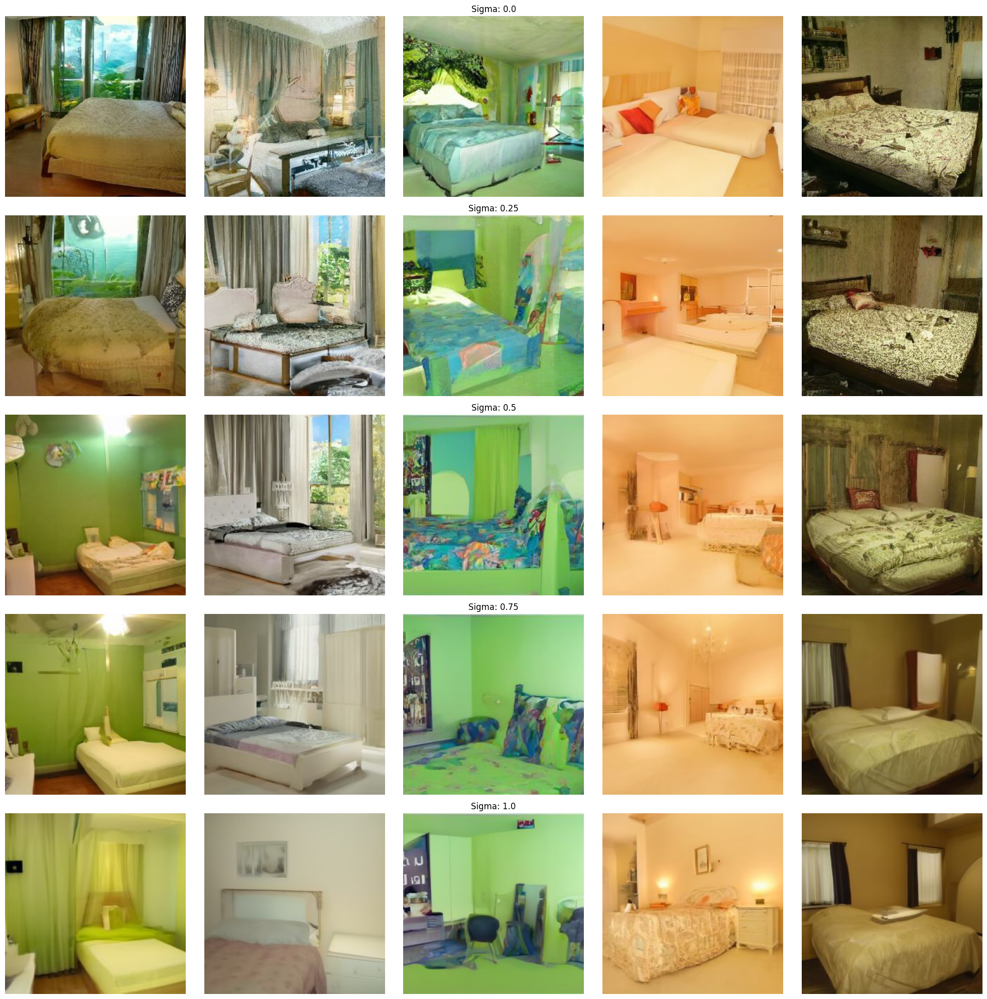

In [ ]:
import matplotlib.pyplot as plt
n_samples = 5
sample_idcs = range(5)
fig, axs = plt.subplots(len(img_sigma_samples), n_samples, figsize=(4 * len(img_sigma_samples), 4 * n_samples))
for i, (sigma, imgs) in enumerate(img_sigma_samples.items()):
    axs[i, 2].set_title(f"Sigma: {sigma}")
    for j, idx in enumerate(sample_idcs):
        image_processed = imgs[idx].cpu().permute(0, 2, 3, 1)
        image_processed = (image_processed + 1.0) * 127.5
        image_processed = image_processed.numpy().astype(np.uint8)
        axs[i, j].imshow(image_processed[0,:,:,:])
        axs[i, j].axis('off')
plt.tight_layout()
plt.savefig('50timesteps_sig_sweep.png', bbox_inches='tight')
plt.show()

**1000 timesteps**

In [ ]:
scheduler.set_timesteps(num_inference_steps = 1000)

img_sigma_samples = {}
for sigma in [0.0, 0.25, 0.5, 0.75, 1.0]:
  images_samples = []
  for n in range(5):
    torch.manual_seed(n)
    noisy_sample = torch.randn(
      1, model.config.in_channels, model.config.sample_size, model.config.sample_size
  )

    noisy_sample = noisy_sample.to("cuda")
    
    sample = noisy_sample
    print(sample.shape)
    for i, t in enumerate(tqdm.tqdm(scheduler.timesteps)):
      # 1. predict noise residual
      with torch.no_grad():
          residual = model(sample, t).sample

      # 2. compute previous image and set x_t -> x_t-1
      sample = scheduler.step(residual, t, sample, eta = sigma).prev_sample
    images_samples.append(sample)
  img_sigma_samples[sigma] = images_samples


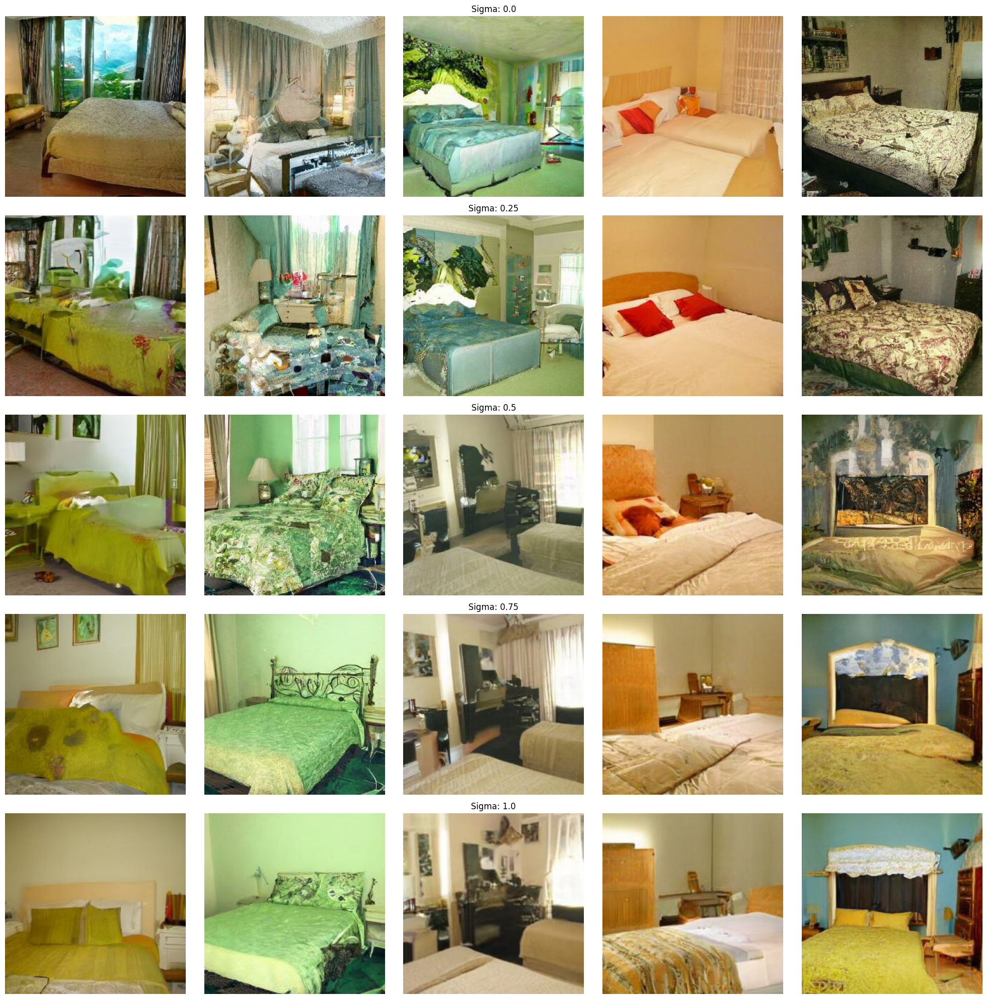

In [ ]:
import matplotlib.pyplot as plt
n_samples = 5
sample_idcs = range(5)
fig, axs = plt.subplots(len(img_sigma_samples), n_samples, figsize=(4 * len(img_sigma_samples), 4 * n_samples))
for i, (sigma, imgs) in enumerate(img_sigma_samples.items()):
    axs[i, 2].set_title(f"Sigma: {sigma}")
    for j, idx in enumerate(sample_idcs):
        image_processed = imgs[idx].cpu().permute(0, 2, 3, 1)
        image_processed = (image_processed + 1.0) * 127.5
        image_processed = image_processed.numpy().astype(np.uint8)
        axs[i, j].imshow(image_processed[0,:,:,:])
        axs[i, j].axis('off')
plt.tight_layout()
plt.savefig('1000timesteps_sig_sweep.png', bbox_inches='tight')
plt.show()